In [2]:
# %load retinanet_train.py
#!/usr/bin/env python

# In[1]:

print("Start importing package...")
import time
import os
import copy
import argparse
import pdb
import collections
import sys

import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
from torch.autograd import Variable
from torchvision import datasets, models, transforms
import torchvision

import model
from anchors import Anchors
import losses
from dataloader import CocoDataset, CSVDataset, collater, Resizer, AspectRatioBasedSampler, Augmenter, UnNormalizer, Normalizer
from torch.utils.data import Dataset, DataLoader

import coco_eval
import csv_eval
import visdom
vis = visdom.Visdom(env='retinanet_4fold')

assert torch.__version__.split('.')[1] == '4'

print('CUDA available: {}'.format(torch.cuda.is_available()))
os.environ["CUDA_VISIBLE_DEVICES"] = "0"
#参数
NAME="RSNA"
DATA_PATH = "/data/krf/dataset"
CSV_TRAINS = [DATA_PATH + "/csv_train0.csv",DATA_PATH + "/csv_train1.csv",DATA_PATH + "/csv_train2.csv",DATA_PATH + "/csv_train3.csv"]
CSV_VALS = [DATA_PATH + "/csv_val0.csv",DATA_PATH + "/csv_val1.csv",DATA_PATH + "/csv_val2.csv",DATA_PATH + "/csv_val3.csv"]
CSV_CLASSES = DATA_PATH + "/classes.csv"
TEST_PATH = DATA_PATH+"/stage_1_test_images"
DEPTH = 101
EPOCHS = 20
BATCH_SIZE=2
VAL_SIZE = 3000
#TRAIN_SIZE = 100
#数据预处理
import csv
import random
from tqdm import tqdm
from mydataloader import  MyDataset,TestDataset,NormalizerTest,ResizerTest,collaterTest


Start importing package...
CUDA available: True


In [3]:

dataset_test = TestDataset(TEST_PATH,transform=transforms.Compose([NormalizerTest(), ResizerTest()]))
print(len(dataset_test))

sampler_test = AspectRatioBasedSampler(dataset_test, batch_size=1, drop_last=False)
dataloader_test = DataLoader(dataset_test, num_workers=1, collate_fn=collaterTest, batch_sampler=sampler_test)

retinanets = []
for i in range(4):  
    retinanets.append(torch.load("weights_stage1/{}_model_final.pt".format(i)))

for i in range(4):
    retinanets[i] = retinanets[i].cuda()
    retinanets[i].eval()

unnormalize = UnNormalizer()

1000


In [4]:
import numpy as np
# helper function to calculate IoU
def iou(box1, box2):
    x11, y11, w1, h1 = box1
    x21, y21, w2, h2 = box2
    #assert w1 * h1 > 0
    #assert w2 * h2 > 0
    x12, y12 = x11 + w1, y11 + h1
    x22, y22 = x21 + w2, y21 + h2

    area1, area2 = w1 * h1, w2 * h2
    xi1, yi1, xi2, yi2 = max([x11, x21]), max([y11, y21]), min([x12, x22]), min([y12, y22])
    
    if xi2 <= xi1 or yi2 <= yi1:
        return 0
    else:
        intersect = (xi2-xi1) * (yi2-yi1)
        union = area1 + area2 - intersect
        return intersect / union
    
# simple test
box1 = [100, 100, 200, 200]
box2 = [100, 100, 300, 200]
print(iou(box1, box2))
def map_iou(boxes_true, boxes_pred, scores, thresholds = [0.4, 0.45, 0.5, 0.55, 0.6, 0.65, 0.7, 0.75],min_conf=0):
    """
    Mean average precision at differnet intersection over union (IoU) threshold
    
    input:
        boxes_true: Mx4 numpy array of ground true bounding boxes of one image. 
                    bbox format: (x1, y1, w, h)
        boxes_pred: Nx4 numpy array of predicted bounding boxes of one image. 
                    bbox format: (x1, y1, w, h)
        scores:     length N numpy array of scores associated with predicted bboxes
        thresholds: IoU shresholds to evaluate mean average precision on
    output: 
        map: mean average precision of the image
    """
    
    # According to the introduction, images with no ground truth bboxes will not be 
    # included in the map score unless there is a false positive detection (?)
        
    # return None if both are empty, don't count the image in final evaluation (?)
    if len(boxes_true) == 0 or len(boxes_pred) == 0:
        return 0
    
    assert boxes_true.shape[1] == 4 or boxes_pred.shape[1] == 4, "boxes should be 2D arrays with shape[1]=4"
    if len(boxes_pred):
        assert len(scores) == len(boxes_pred), "boxes_pred and scores should be same length"
        # sort boxes_pred by scores in decreasing order
        scores = np.array(scores)
        boxes_pred = boxes_pred[scores>=min_conf]
        scores = scores[scores>=min_conf]
        boxes_pred = boxes_pred[np.argsort(scores)[::-1], :]
        
    if len(boxes_true) == 0 and len(boxes_pred) == 0:
        return 0
    
    map_total = 0
    
    # loop over thresholds
    for t in thresholds:
        matched_bt = set()
        tp, fn = 0, 0
        for i, bt in enumerate(boxes_true):
            matched = False
            for j, bp in enumerate(boxes_pred):
                miou = iou(bt, bp)
                if miou >= t and not matched and j not in matched_bt:
                    matched = True
                    tp += 1 # bt is matched for the first time, count as TP
                    matched_bt.add(j)
            if not matched:
                fn += 1 # bt has no match, count as FN
                
        fp = len(boxes_pred) - len(matched_bt) # FP is the bp that not matched to any bt
        m = tp / (tp + fn + fp)
        map_total += m
    
    return map_total / len(thresholds)
# simple test
boxes_true = np.array([[100, 100, 200, 200]])
boxes_pred = np.array([[100, 100, 300, 200]])
scores = [0.9]

map_iou(boxes_true, boxes_pred, scores)

0.6666666666666666


0.75

In [5]:
def nms(boxes,scores,threshold = 0.3):
    if len(boxes):
        assert len(scores) == len(boxes), "boxes and scores should be same length"
        # sort boxes_pred by scores in decreasing order
        scores = np.array(scores)
        #boxes_pred = boxes_pred[scores>=min_conf]
        #scores = scores[scores>=min_conf]
        boxes = boxes[np.argsort(scores)[::-1], :]
    final_boxes = []
    final_scores = []
    for i,box in enumerate(boxes):
        flag = 0
        for j,fbox in enumerate(final_boxes):
            iou_ = iou(box,fbox)
            print(iou_)
            if iou_ > threshold :
                flag = 1 # 已存在
                break
        if flag == 0:
            final_boxes.append(box)
            final_scores.append(scores[i])
    final_boxes = np.array(final_boxes)
    final_scores = np.array(final_scores)
    return final_boxes,final_scores
        

In [15]:
import pandas as pd
from ensemble import GeneralEnsemble
filepath = "/data/krf/dataset/stage_1_test_labels.csv"
df = pd.read_csv(filepath)
sum_ = 0.0
count = 0
for idx, data in enumerate(dataloader_test):
    patientId = os.path.splitext(os.path.basename(data['names'][0]))[0]
    print(patientId)
    results = df[df["patientId"]==patientId].values
    boxes_true = np.array([])
    if results[0][5] == 1:
        
        boxes_true = results[:,1:5]
        #print(boxes_true)
        boxes_true = np.array(boxes_true)
        boxes_true = boxes_true.astype(np.int)
    
    print("boxes_true:",boxes_true)
    boxes_pred = []
    ss = []
    resize_factor = 2 #输入的是512，原图像是1024
    with torch.no_grad():
            st = time.time()
            #try:
            if 1 ==1:
                idxs4 = []
                scores4 = []
                transformed_anchors4 = []
                dets = []
                for i in range(4):
                    scores, classification, transformed_anchors = retinanets[i](data['img'].cuda().float())
                    scores4.append(scores)
                    transformed_anchors4.append(transformed_anchors)
                    #print('Elapsed time: {}'.format(time.time()-st))
                    #print(idxs)
                    idxs = np.where(scores>0.5)
                    #print(idxs)
                    bbox = []
                    idxs4.append(idxs)
#                     for j in range(idxs[0].shape[0]):
#                         boxes_pred = transformed_anchors[idxs[0][j], :]*resize_factor
#                         print("before",i,transformed_anchors[idxs[0][j], :]*resize_factor)
#                         boxes_pred = boxes_pred[np.argsort(scores)[::-1], :]
#                         print("after",i,transformed_anchors[idxs[0][j], :]*resize_factor)
                    bboxes = []
                    for j in range(idxs[0].shape[0]):
                        bbox = transformed_anchors[idxs[0][j], :]*resize_factor
                        bbox = bbox.cpu().numpy()
                        cx = (bbox[0]+bbox[2])/2
                        cy = (bbox[1]+bbox[3])/2
                        w = bbox[2]-bbox[0]
                        h = bbox[3]-bbox[1]
                        s = scores[idxs[0][j]].cpu().numpy()
                        #print("score:",s)
                        bboxes.append([cx,cy,w,h,1,s])
                        #print("before",i,transformed_anchors[idxs[0], :]*resize_factor)
                    if len(bboxes) > 0:
                        dets.append(bboxes)
                #print(dets)
                ensembleBox=[]
                if len(dets) >= 2:
                    ensembleBox = GeneralEnsemble(dets,iou_thresh = 0.4)
                    print("after ensemble",ensembleBox)
                #break
                
                for j in range(len(ensembleBox)):
                    bbox = ensembleBox[j]
                    x1 = bbox[0] - (bbox[2]/2)*0.85
                    y1 = bbox[1] - (bbox[3]/2)*0.85
#                     x2 = bbox[0] + bbox[2]/2
#                     y2 = bbox[1] + bbox[3]/2
                    #label_name = dataset_val.labels[int(classification[idxs[0][j]])]
                    #draw_caption(img, (x1, y1, x2, y2), "1")

                    #cv2.rectangle(img, (x1, y1), (x2, y2), color=(0, 0, 255), thickness=2)
                    #print(label_name)
                    width = bbox[2]*0.85
                    height = bbox[3]*0.85
                    
                    s = bbox[5]
                    print("score:",s)
                    if s > 0:#MIN CONFIDENCE
                        boxes_pred.append([x1,y1,width,height])
                        ss.append(s)
                boxes_pred = np.array(boxes_pred)
                if len(boxes_pred) > 0:
                    boxes_pred = boxes_pred.astype(np.int)
                #print("boxes_pred:",boxes_pred)
                boxes_pred,ss = nms(boxes_pred,ss)
                iou_ = map_iou(boxes_true,boxes_pred,ss)
                if len(boxes_true) > 0 or len(boxes_pred) > 0:
                    count += 1
                    print("iou:",iou_)
                sum_ += iou_
#             except Exception as e:
#                 print(e)
#                 continue 
print(count)
print("LB score:",sum_/count)

03946ed8-d581-4403-b052-753820035d6d
boxes_true: []
0f68958e-1720-4511-a9c2-b1d217d92243
boxes_true: []
23ae7f52-f3be-4b6f-ba8f-ac2a72f433fc
boxes_true: [[634 594 214 226]]
after ensemble [[386.74420166015625, 662.9230651855469, 196.61117553710935, 295.03724670410156, 1, 0.34008951981862384], [739.07958984375, 633.4541015625, 304.56592, 591.76294, 1, array(0.1884135, dtype=float32)], [728.1638793945312, 540.815673828125, 217.12305, 256.0277, 1, array(0.20175284, dtype=float32)]]
score: 0.34008951981862384
score: 0.1884135
score: 0.20175284
0
0
0.3082862349053399
iou: 0.0
2afaf9b4-664c-4c87-b9f5-4e411789da5d
boxes_true: [[663 243  98 196]]
after ensemble [[724.5795593261719, 566.7252502441406, 265.59393310546875, 680.1860961914062, 1, 0.5459755957126617]]
score: 0.5459755957126617
iou: 0.0
0e03c2d7-9cea-4dc7-8e91-794a8b3ff58d
boxes_true: [[654 444 160 103]
 [531 206 289 213]
 [686 545 128 106]
 [213 386 114 161]]
after ensemble [[693.2909545898438, 313.4698486328125, 210.54211, 209.4274

after ensemble [[319.35799407958984, 485.51585388183594, 227.7474365234375, 393.49249267578125, 1, 0.6956083625555038], [677.9798787434896, 534.3806762695312, 257.4497884114583, 404.0293884277344, 1, 0.4691128581762314]]
score: 0.6956083625555038
score: 0.4691128581762314
0
iou: 0.4166666666666667
0f4b80b6-fd39-451f-aebf-7cdb1b655c0b
boxes_true: []
0e266ced-46fe-4868-8a5a-ef1be71d8f9a
boxes_true: []
239e9d1c-e5c1-4798-a6ba-64fd64e7c486
boxes_true: [[701 435 160 276]]
after ensemble [[780.2279357910156, 557.6553955078125, 180.2537841796875, 268.3673858642578, 1, 0.6673718988895416]]
score: 0.6673718988895416
iou: 1.0
2456fcb4-82bd-4fa9-8ef2-8e1250c3ff50
boxes_true: [[210 451 139 167]]
after ensemble [[267.69699478149414, 498.9551696777344, 262.99747467041016, 234.50048828125, 1, 0.7086501270532608]]
score: 0.7086501270532608
iou: 0.125
037e120a-24fa-4f9c-8813-111136e3c288
boxes_true: []
after ensemble [[682.5830993652344, 419.00469970703125, 298.7772216796875, 651.86279296875, 1, 0.3134

after ensemble [[223.61520385742188, 698.0580596923828, 214.94128799438477, 377.1556625366211, 1, 0.6493858098983765], [617.6332550048828, 644.9254608154297, 239.19690704345703, 485.9980773925781, 1, 0.6225344836711884]]
score: 0.6493858098983765
score: 0.6225344836711884
0
iou: 0.125
0e9f4af5-64ae-41aa-b331-e012e28caac4
boxes_true: []
after ensemble [[712.0213623046875, 624.8604736328125, 221.3524169921875, 253.2030029296875, 1, 0.38571552435557044], [376.25103759765625, 274.580322265625, 148.24426, 170.63513, 1, array(0.18620354, dtype=float32)], [289.20692443847656, 627.0778198242188, 222.29471588134763, 158.94891357421875, 1, 0.37604405482610065]]
score: 0.38571552435557044
score: 0.18620354
score: 0.37604405482610065
0
0
0
iou: 0
02589621-9494-4801-99a8-a4e89c1b525d
boxes_true: [[232 288 141 424]
 [642 307 128 286]]
after ensemble [[299.2627487182617, 461.06949615478516, 268.7578582763672, 598.3300018310547, 1, 0.7375392913818359], [674.1795806884766, 459.46604919433594, 240.83834

after ensemble [[392.8563766479492, 501.33660888671875, 250.7868881225586, 588.3783493041992, 1, 0.6939951330423355], [811.4952545166016, 590.8647766113281, 274.54608154296875, 554.0487060546875, 1, 0.6459474116563797]]
score: 0.6939951330423355
score: 0.6459474116563797
0
iou: 0.0
c18d1138-ba74-4af5-af21-bdd4d2c96bb5
boxes_true: [[646 386 141 206]
 [295 473 133 176]]
after ensemble [[709.0556335449219, 415.72979736328125, 187.8726806640625, 323.9297637939453, 1, 0.3948027491569519], [350.21781412760413, 554.1076049804688, 189.58648173014322, 239.39221191406247, 1, 0.5619029402732849]]
score: 0.3948027491569519
score: 0.5619029402732849
0
iou: 0.4583333333333334
23997b8b-5726-4b2d-bd45-b15fc1c4c2af
boxes_true: [[143 620 216 194]]
after ensemble [[252.23620096842447, 732.6621500651041, 238.07716369628903, 172.3448486328125, 1, 0.7494583924611409]]
score: 0.7494583924611409
iou: 0.875
0f60ce12-960f-4ecf-8c71-040737565327
boxes_true: []
after ensemble [[388.33097330729163, 468.47779337565

iou: 0
2bf8a7ed-b4a5-4ea1-b8e8-cadc7f7adf2d
boxes_true: [[179 254 253 523]]
after ensemble [[719.7003173828125, 531.3477783203125, 229.79683430989581, 189.08621215820312, 1, 0.7110594908396403], [289.33498128255206, 535.5590006510416, 257.27330017089844, 483.18286132812494, 1, 0.5958392222722371]]
score: 0.7110594908396403
score: 0.5958392222722371
0
iou: 0.375
c104d585-85a7-4071-b7ff-930ac2565128
boxes_true: []
after ensemble [[292.2487335205078, 628.3113403320312, 243.853271484375, 239.39117431640625, 1, 0.6916979551315308], [701.2588500976562, 648.9725952148438, 190.91333, 281.41748, 1, array(0.2821871, dtype=float32)]]
score: 0.6916979551315308
score: 0.2821871
0
iou: 0
2a740d72-0dc4-4439-93ed-60cad708d7c4
boxes_true: []
after ensemble [[320.31058756510413, 608.8688354492188, 217.1005859375, 194.91691080729163, 1, 0.5850334564844767]]
score: 0.5850334564844767
iou: 0
1dbcb00b-ba8e-466c-99a9-0beaee915ec3
boxes_true: []
10ec7da5-0d58-4c84-bcdc-180591028054
boxes_true: []
2812705b-aea

iou: 0
303390de-3812-4aae-893f-3f18897a6c21
boxes_true: [[569 603 197 107]
 [204 551 203 156]]
after ensemble [[325.03607177734375, 629.3231811523438, 222.21394856770831, 216.42964680989581, 1, 0.6520580252011616], [684.9202880859375, 572.7049560546875, 279.786, 606.6758, 1, array(0.21352702, dtype=float32)], [696.2236938476562, 564.7930297851562, 213.30774, 261.8773, 1, array(0.19593386, dtype=float32)]]
score: 0.6520580252011616
score: 0.21352702
score: 0.19593386
0
0
0.3292122403834337
iou: 0.29166666666666663
22ce653c-e7f4-45d5-9c5e-4abdc753b1b0
boxes_true: [[647 421 142 223]
 [279 560 149 152]]
after ensemble [[345.77134195963544, 606.3421020507812, 183.33332316080728, 211.3387451171875, 1, 0.5173986852169037], [702.5238037109375, 512.9501342773438, 203.58209228515625, 410.3902587890625, 1, 0.2942506968975067]]
score: 0.5173986852169037
score: 0.2942506968975067
0
iou: 0.45833333333333337
2c96c09b-aaa8-4c07-8e69-c2210f04be2d
boxes_true: []
after ensemble [[789.7216491699219, 667.0

04ce0574-5d18-4661-973f-7bfbb0707a1c
boxes_true: [[551 249 240 429]
 [228 230 134 328]]
after ensemble [[290.80384318033856, 407.2881164550781, 247.8805948893229, 517.3475545247396, 1, 0.5204574018716812], [661.320068359375, 481.2654571533203, 262.2982177734375, 553.2671203613281, 1, 0.29709145426750183], [669.7073364257812, 422.67022705078125, 156.57568, 273.66565, 1, array(0.15741648, dtype=float32)]]
score: 0.5204574018716812
score: 0.29709145426750183
score: 0.15741648
0
0
0.2957255127467893
iou: 0.35416666666666663
2ec88120-5cef-45a0-b9d6-629fdf99ab8c
boxes_true: []
after ensemble [[345.54176330566406, 690.43603515625, 222.6932830810547, 179.82803344726562, 1, 0.6840941458940506], [752.246337890625, 618.9668426513672, 250.80203247070312, 293.55677795410156, 1, 0.6316230595111847]]
score: 0.6840941458940506
score: 0.6316230595111847
0
iou: 0
2d0ebb7e-9c57-4a78-9728-e79b0f2bc91c
boxes_true: [[594 513 250 207]]
after ensemble [[738.4589640299479, 590.8932291666666, 316.5114339192708,

after ensemble [[797.295206705729, 679.4332478841145, 189.6925048828125, 160.57763671875, 1, 0.6213200092315674], [339.3878479003906, 737.0291137695312, 128.75934, 129.56323, 1, array(0.23912112, dtype=float32)], [355.677978515625, 442.3182678222656, 204.73781, 218.94891, 1, array(0.22179848, dtype=float32)]]
score: 0.6213200092315674
score: 0.23912112
score: 0.22179848
0
0
0
iou: 0.125
27ee75df-d2e3-40c0-994f-3efd14e6dafb
boxes_true: [[251 193 258 482]
 [638 204 238 554]]
after ensemble [[368.5441385904948, 537.8386840820312, 217.7771759033203, 232.22075398763022, 1, 0.5646600276231766], [758.8755086263021, 529.0709838867188, 252.66768391927084, 502.9834798177083, 1, 0.4188540577888489], [381.76385498046875, 409.0985107421875, 279.83484, 584.5425, 1, array(0.13356917, dtype=float32)]]
score: 0.5646600276231766
score: 0.4188540577888489
score: 0.13356917
0
0.3100330066693889
iou: 0.24999999999999997
103451bb-1f8c-4209-abce-0be7e9a6c8fb
boxes_true: [[305 210 170 220]
 [641 215 141 170]]

after ensemble [[332.3943862915039, 445.81272888183594, 274.1248321533203, 593.981689453125, 1, 0.6829317808151245], [732.771484375, 487.1881103515625, 280.83770751953125, 697.597412109375, 1, 0.30318790674209595], [746.90380859375, 622.1553344726562, 214.42822, 293.46744, 1, array(0.13485022, dtype=float32)]]
score: 0.6829317808151245
score: 0.30318790674209595
score: 0.13485022
0
0
0.3216414944356121
iou: 0.6666666666666665
12c8845f-9011-49f4-a9c3-e2121b8bcef3
boxes_true: []
after ensemble [[236.3245086669922, 778.744873046875, 217.97696, 189.17615, 1, array(0.3663545, dtype=float32)], [719.6624755859375, 774.9976806640625, 222.82056, 266.7345, 1, array(0.26093805, dtype=float32)]]
score: 0.3663545
score: 0.26093805
0
iou: 0
233fa720-d58a-4db3-beac-e99002f7080e
boxes_true: []
after ensemble [[336.49424743652344, 601.2114410400391, 168.96444702148438, 209.3770523071289, 1, 0.6412754952907562]]
score: 0.6412754952907562
iou: 0
1c0a5548-0e11-4793-b48e-97236374c768
boxes_true: []
after e

2baa8ae3-27e1-4193-b51e-68e2a1cc516a
boxes_true: []
after ensemble [[351.3866373697917, 786.9763590494791, 209.32047017415366, 300.174072265625, 1, 0.46382078528404236], [789.1852111816406, 784.9541625976562, 229.12371826171875, 293.582275390625, 1, 0.3228977769613266], [362.256591796875, 712.3538208007812, 268.38696, 591.2892, 1, array(0.1270956, dtype=float32)]]
score: 0.46382078528404236
score: 0.3228977769613266
score: 0.1270956
0
0.3943436779198993
iou: 0
1cee8f22-8603-49a8-a69c-ea807158db1b
boxes_true: [[209 475 142 166]
 [572 490 161 228]]
after ensemble [[278.7612533569336, 476.45337677001953, 241.77386856079102, 441.1344757080078, 1, 0.6681659668684006], [680.9353637695312, 587.3495788574219, 168.2718505859375, 201.26605224609375, 1, 0.3022470325231552], [667.14306640625, 452.906494140625, 245.61145, 550.51685, 1, array(0.15870366, dtype=float32)]]
score: 0.6681659668684006
score: 0.3022470325231552
score: 0.15870366
0
0
0.25173982869379014
iou: 0.09375
0523a43b-64f4-4ffb-81dd

after ensemble [[360.80255126953125, 478.64697265625, 123.93856811523438, 155.9058074951172, 1, 0.6094060838222504]]
score: 0.6094060838222504
iou: 0
1eef9264-e6e3-41ba-b5fa-6a2ab638a7c9
boxes_true: [[526 641 109 153]]
after ensemble [[284.25319417317706, 548.1312255859375, 208.3427937825521, 479.6847839355469, 1, 0.5113945454359055], [627.7106628417969, 514.7413940429688, 248.28369140625, 632.311767578125, 1, 0.2781781703233719]]
score: 0.5113945454359055
score: 0.2781781703233719
0
iou: 0.0
1c807df9-7cf0-4f02-bb16-7ad88384ef2e
boxes_true: [[565 502 136 211]
 [149 605 184 166]
 [521 159 151 156]]
after ensemble [[236.45153045654297, 705.6395874023438, 217.85315704345703, 262.381103515625, 1, 0.4202123135328293], [631.0332438151041, 572.5893758138021, 215.064208984375, 410.6011149088542, 1, 0.40581682324409485], [246.16903686523438, 571.0989990234375, 278.03814697265625, 649.8793334960938, 1, 0.2871251404285431]]
score: 0.4202123135328293
score: 0.40581682324409485
score: 0.28712514042

after ensemble [[368.4623489379883, 567.9410095214844, 248.21870040893555, 463.2432327270508, 1, 0.6712850779294968], [761.0112101236979, 582.5375569661459, 219.32857259114584, 302.31055704752606, 1, 0.483321875333786]]
score: 0.6712850779294968
score: 0.483321875333786
0
iou: 0.125
28eaff00-5fb7-40ee-8206-9d2ff5b081e0
boxes_true: []
00a05408-8291-4231-886e-13763e103161
boxes_true: [[156 187 173 371]
 [491 194 156 222]]
after ensemble [[236.11248016357422, 384.15904235839844, 212.35295486450195, 336.180362701416, 1, 0.707004576921463], [587.913330078125, 345.88475799560547, 202.9642333984375, 323.69786071777344, 1, 0.6397796869277954], [606.5665893554688, 526.89990234375, 295.77527, 751.277, 1, array(0.14971164, dtype=float32)]]
score: 0.707004576921463
score: 0.6397796869277954
score: 0.14971164
0
0
0.29537024316526994
iou: 0.4270833333333333
1c7c7be7-497e-4751-89e4-09d4209a8e2a
boxes_true: [[517 573 182 149]]
after ensemble [[624.0147399902344, 597.1472778320312, 243.33111572265625, 

after ensemble [[333.0911865234375, 530.9374389648438, 195.3138427734375, 187.24449157714844, 1, 0.6376729607582092]]
score: 0.6376729607582092
iou: 0
000fe35a-2649-43d4-b027-e67796d412e0
boxes_true: [[570 282 269 409]
 [ 83 227 296 438]]
after ensemble [[226.27356338500977, 433.9943084716797, 307.5651626586914, 417.36944580078125, 1, 0.7942875772714615], [695.3761596679688, 481.5863494873047, 297.62603759765625, 407.81006622314453, 1, 0.7801956534385681]]
score: 0.7942875772714615
score: 0.7801956534385681
0
iou: 0.9166666666666666
0fc18a4c-0666-4287-a25d-e295bcb18351
boxes_true: []
after ensemble [[348.4923400878906, 473.3100128173828, 246.62713623046875, 188.99356079101562, 1, 0.5391273697217305], [785.1014404296875, 665.7778930664062, 214.44067, 246.63354, 1, array(0.2446078, dtype=float32)], [309.7378845214844, 517.226806640625, 315.279, 367.67126, 1, array(0.19507766, dtype=float32)]]
score: 0.5391273697217305
score: 0.2446078
score: 0.19507766
0
0.37501177800810326
iou: 0
1ccf9c

after ensemble [[761.6183471679688, 591.8016967773438, 242.5614, 384.04272, 1, array(0.23216854, dtype=float32)], [374.47370402018225, 612.5869954427083, 197.121826171875, 244.62836710611978, 1, 0.5805195569992065]]
score: 0.23216854
score: 0.5805195569992065
0
iou: 0.5833333333333333
1c187dbf-3fa4-4a39-914a-39994b76d4c5
boxes_true: [[615 452  67 113]
 [279 396 191 207]]
after ensemble [[693.5005340576172, 545.7857818603516, 235.92669677734375, 267.0663528442383, 1, 0.7218483537435532], [377.24810791015625, 535.7738647460938, 171.10779, 280.49512, 1, array(0.16885501, dtype=float32)]]
score: 0.7218483537435532
score: 0.16885501
0
iou: 0.16666666666666666
1d1d8348-c6cf-4dc4-a577-a75fa779f8f7
boxes_true: []
after ensemble [[252.26890563964844, 553.2387084960938, 232.3588, 177.62936, 1, array(0.25556287, dtype=float32)], [641.1751098632812, 527.027099609375, 259.69348, 227.16772, 1, array(0.25055623, dtype=float32)]]
score: 0.25556287
score: 0.25055623
0
iou: 0
13752451-7571-4b2a-8f3e-b71

after ensemble [[749.7274373372395, 660.1250610351562, 262.589599609375, 176.2113037109375, 1, 0.8122364083925883], [305.4186604817708, 554.0751749674479, 214.3918762207031, 234.09503173828122, 1, 0.7049749096234639]]
score: 0.8122364083925883
score: 0.7049749096234639
0
iou: 0.5
23dde3cd-bdf6-4586-bf6d-8e3306c71455
boxes_true: []
12e5493a-1f4b-463b-a373-67981fc1e76a
boxes_true: []
after ensemble [[311.06068420410156, 645.5273742675781, 191.72662353515625, 254.8218536376953, 1, 0.5333254933357239]]
score: 0.5333254933357239
iou: 0
1caa138f-f729-4693-9693-74b14cbb0d50
boxes_true: []
281e2883-3c05-400b-a340-6a23628a6b1c
boxes_true: []
after ensemble [[811.88623046875, 483.75030517578125, 209.61212158203125, 211.1109619140625, 1, 0.3076348453760147], [325.982177734375, 468.0696716308594, 212.2429428100586, 212.24209594726562, 1, 0.37403206527233124], [773.6630554199219, 414.97027587890625, 309.7608642578125, 585.545166015625, 1, 0.3600638657808304], [332.3211669921875, 357.4571838378906, 

iou: 0
26aa5215-a443-459f-9aeb-976e65c11261
boxes_true: [[631 193 186 164]]
after ensemble [[723.5713500976562, 263.54638671875, 225.09879557291666, 209.737060546875, 1, 0.5879578739404678], [300.0158996582031, 528.2942810058594, 257.1012840270996, 166.70561981201172, 1, 0.654236912727356]]
score: 0.5879578739404678
score: 0.654236912727356
0
iou: 0.5
c0d8eb9f-8276-414b-8cbb-d8f28b61aac1
boxes_true: []
03774732-81ca-4da0-a35c-ec222c14a4c9
boxes_true: []
after ensemble [[344.59515380859375, 405.14215087890625, 190.1477, 422.40372, 1, array(0.2526135, dtype=float32)], [705.8196411132812, 556.603515625, 196.12415, 240.08862, 1, array(0.28495738, dtype=float32)]]
score: 0.2526135
score: 0.28495738
0
iou: 0
1ed9d674-2a7d-40d9-b40d-e754fc49938e
boxes_true: []
after ensemble [[416.3189392089844, 466.14752197265625, 222.25604, 160.0079, 1, array(0.3170409, dtype=float32)], [761.7725830078125, 488.76104736328125, 171.71362, 168.64075, 1, array(0.2511115, dtype=float32)]]
score: 0.3170409
score:

0e9d2259-5faa-4000-969c-f4d25d4eed0d
boxes_true: []
after ensemble [[289.7890930175781, 461.48779296875, 212.1640625, 247.24859619140625, 1, 0.36576178669929504], [712.7870686848959, 471.83559163411456, 261.0219319661458, 581.0643310546875, 1, 0.53839510679245], [301.42445373535156, 460.1764831542969, 320.8744201660156, 488.91033935546875, 1, 0.31107068061828613]]
score: 0.36576178669929504
score: 0.53839510679245
score: 0.31107068061828613
0
0
0.33486888731396175
iou: 0
c1e73a4e-7afe-4ec5-8af6-ce8315d7a2f2
boxes_true: [[666 418 186 223]
 [316 504 179 273]]
after ensemble [[410.2670135498047, 582.5670471191406, 198.61070251464844, 362.6161346435547, 1, 0.6412882506847382], [748.7445678710938, 515.5792846679688, 214.00921630859375, 318.7488250732422, 1, 0.30454203486442566]]
score: 0.6412882506847382
score: 0.30454203486442566
0
iou: 0.7083333333333333
3022b5a2-88d8-48b8-8f90-55e037f4e86b
boxes_true: []
26f43936-9d55-4a68-b58e-4659a86cdb0e
boxes_true: []
1ac5f0e8-f431-4400-b3f5-4a2224e5

2dd692a5-a60c-443e-8299-af5d03949b60
boxes_true: [[558 714 243 157]]
iou: 0
2263b413-900d-4c5a-99cc-bb551a39f131
boxes_true: []
2e1956e1-8430-48d7-9888-910934acd22b
boxes_true: [[613 440 247 201]
 [191 473 171 135]]
after ensemble [[305.59232330322266, 546.2739410400391, 213.38225173950195, 154.25436401367188, 1, 0.8036107271909714], [726.9480794270834, 556.8179524739584, 244.5662841796875, 276.2524719238281, 1, 0.4114566296339035]]
score: 0.8036107271909714
score: 0.4114566296339035
0
iou: 0.7916666666666666
0088be53-27f2-4c30-882b-a73a3a5c8c71
boxes_true: []
c164b17b-aff8-484f-9d9e-dde2932d8df9
boxes_true: []
2d8258d0-7dd4-4de2-a3f7-9501e25883e7
boxes_true: []
after ensemble [[352.2099151611328, 548.2250823974609, 182.93774032592773, 182.02197265625, 1, 0.6465041041374207]]
score: 0.6465041041374207
iou: 0
03cf39fd-692c-46db-80d2-f1efb09b0e31
boxes_true: []
2490b2de-41fb-41dc-a73d-7e946c86124b
boxes_true: []
2bdfab0d-4192-4a7f-a366-587c379ecdba
boxes_true: [[238 188 212 521]
 [587 19

after ensemble [[766.3879852294922, 440.89517974853516, 273.12652587890625, 560.4038772583008, 1, 0.658292219042778], [351.7771453857422, 426.45397186279297, 284.91224670410156, 597.5779571533203, 1, 0.6092340052127838]]
score: 0.658292219042778
score: 0.6092340052127838
0
iou: 0.25
1497c967-d7c7-4c43-abd0-66a71e68e66f
boxes_true: [[646 645 142 134]]
after ensemble [[312.27899169921875, 661.6694132486979, 195.86331685384116, 174.77909342447916, 1, 0.4954091012477875], [704.6325073242188, 717.0699157714844, 171.19964599609375, 150.13616943359375, 1, 0.2818717956542969]]
score: 0.4954091012477875
score: 0.2818717956542969
0
iou: 0.5
14bc705c-8688-43f3-b1dd-90b0a4deebd5
boxes_true: []
28a2d8aa-9e29-48d4-b1e3-029e3451ce0b
boxes_true: [[200 213 220 583]
 [583 235 257 570]]
after ensemble [[669.9067840576172, 472.45035552978516, 253.4537353515625, 605.6776657104492, 1, 0.7543506324291229], [300.5193786621094, 483.4936218261719, 245.10715866088867, 534.9900817871094, 1, 0.7706617265939713]]
s

after ensemble [[359.82212829589844, 588.0518341064453, 245.86911010742188, 229.92496490478516, 1, 0.6476593315601349], [771.1366271972656, 583.2053833007812, 285.82568359375, 373.4080810546875, 1, 0.27915501594543457], [779.186767578125, 600.1068115234375, 308.19287, 626.03345, 1, array(0.18055399, dtype=float32)]]
score: 0.6476593315601349
score: 0.27915501594543457
score: 0.18055399
0
0
0.5524875406908075
iou: 0.5
243d4ffb-6f8d-48d4-aa86-e93dcbb7b238
boxes_true: []
308cf5b6-fcaf-4673-bc75-737b8d67b889
boxes_true: [[596 353 229 415]
 [275 303 130 380]]
after ensemble [[297.70379638671875, 518.6771850585938, 281.8636474609375, 379.2525329589844, 1, 0.42929599682490027], [696.9167277018229, 593.4994913736979, 295.0207112630208, 392.93134562174475, 1, 0.6137808362642924]]
score: 0.42929599682490027
score: 0.6137808362642924
0
iou: 0.4583333333333334
2c0fa3c1-f701-4b25-b9f6-34a10ae2508f
boxes_true: []
1c98cf85-1e50-4def-a8e7-6749808339ff
boxes_true: [[211 631 157 208]
 [635 361 169 223]


after ensemble [[765.8851318359375, 780.5216674804688, 164.7109375, 239.85650634765625, 1, 0.33685553073883057], [321.6865234375, 710.1415100097656, 175.61768341064453, 265.2396240234375, 1, 0.28344210982322693], [330.80357360839844, 547.430908203125, 259.94390869140625, 646.3936767578125, 1, 0.354199543595314], [729.126708984375, 607.4254150390625, 250.64581298828125, 620.8784790039062, 1, 0.3069974184036255]]
score: 0.33685553073883057
score: 0.28344210982322693
score: 0.354199543595314
score: 0.3069974184036255
0
0
0.23622254835619688
0.27599665919671873
0
0
iou: 0.28750000000000003
30c7ba0d-6b34-4a40-a92e-493c756d924a
boxes_true: []
25518fc2-dbc0-4c43-858c-e5a3b8e6c892
boxes_true: []
after ensemble [[265.1068216959635, 519.2559000651041, 236.72459411621094, 235.29286702473956, 1, 0.7608594099680582], [771.5267944335938, 534.8936767578125, 112.35571, 102.68848, 1, array(0.2161408, dtype=float32)]]
score: 0.7608594099680582
score: 0.2161408
0
iou: 0
2beb8746-4e01-499d-ad6a-e29e7b30dd

after ensemble [[322.76234436035156, 530.2189178466797, 224.37038040161133, 212.12045288085938, 1, 0.7367860227823257], [748.8895670572916, 568.7433878580729, 187.96846516927084, 302.55650838216144, 1, 0.5436976850032806]]
score: 0.7367860227823257
score: 0.5436976850032806
0
iou: 0.4166666666666667
bffde351-7ccf-49cd-aa8b-893c7d359e29
boxes_true: [[539 567 178 201]
 [197 614 201 308]]
after ensemble [[270.4010467529297, 790.6602020263672, 248.25743103027344, 349.91448974609375, 1, 0.6562046706676483], [660.5801798502604, 706.5186971028646, 264.0401204427083, 350.7259521484375, 1, 0.45572657883167267]]
score: 0.6562046706676483
score: 0.45572657883167267
0
iou: 0.41666666666666674
1b7f9ebf-bd1c-4195-9186-d6adb65945ee
boxes_true: [[348 313 122 383]]
after ensemble [[780.7468872070312, 701.358642578125, 210.69714, 256.12695, 1, array(0.29939175, dtype=float32)], [376.2571716308594, 501.9583282470703, 194.7335205078125, 344.0837707519531, 1, 0.5189585089683533]]
score: 0.29939175
score: 0

iou: 0
2dfde10a-53c1-4c69-b49a-43aa4543b7f4
boxes_true: []
after ensemble [[365.9342803955078, 652.0932922363281, 207.76727294921875, 226.97930908203125, 1, 0.7204807698726654]]
score: 0.7204807698726654
iou: 0
0db60a41-2a6a-421b-a304-8799739eaec5
boxes_true: []
2db71952-47f3-455b-aed2-675ec9113cf3
boxes_true: []
02475a31-ed48-4ff3-b401-5d74694bff8d
boxes_true: [[134 472 145 197]
 [835 474 112 172]]
after ensemble [[271.56947326660156, 509.55430603027344, 189.6573486328125, 265.6189270019531, 1, 0.779745876789093], [850.2687072753906, 550.3139953613281, 214.82568359375, 183.1571044921875, 1, 0.7475920021533966]]
score: 0.779745876789093
score: 0.7475920021533966
0
iou: 0.125
c0dd2290-7dc1-4589-8061-57dfdfa23a4c
boxes_true: []
after ensemble [[271.6097106933594, 648.4626770019531, 193.29959106445312, 276.1470489501953, 1, 0.6270656585693359]]
score: 0.6270656585693359
iou: 0
27feebaa-f4dc-4c68-9348-f0ff35134e43
boxes_true: [[635 522 251 368]
 [210 590 252 211]]
after ensemble [[379.0561

1a63ca9b-22c9-4856-960f-7cdca38bdfd9
boxes_true: []
after ensemble [[235.59625752766925, 532.7367757161458, 260.6760813395182, 170.79173787434894, 1, 0.6695158084233601], [747.7940063476562, 607.8935546875, 299.25256, 295.78397, 1, array(0.19598627, dtype=float32)]]
score: 0.6695158084233601
score: 0.19598627
0
iou: 0
212ccee9-80ec-4d67-8edb-5959d344c923
boxes_true: []
after ensemble [[700.80224609375, 696.6833190917969, 230.86749267578125, 297.11273193359375, 1, 0.3663333257039388], [370.1171569824219, 668.909423828125, 182.42487, 147.88306, 1, array(0.25038132, dtype=float32)]]
score: 0.3663333257039388
score: 0.25038132
0
iou: 0
2e81e582-821a-4b3c-bd76-48a7d39e3f82
boxes_true: []
after ensemble [[267.27428181966144, 561.4474894205729, 208.79825846354166, 125.4382832845052, 1, 0.49501222372055054], [762.2332153320312, 621.4959411621094, 214.88629150390625, 163.1043701171875, 1, 0.3719741702079773]]
score: 0.49501222372055054
score: 0.3719741702079773
0
iou: 0
246bf123-5a0d-4a3d-b4b4-

0edcf2dd-71fe-4108-9303-24d51b4faf72
boxes_true: [[186 421 183 188]
 [612 549 135 192]]
after ensemble [[259.8996225992839, 531.6031697591146, 228.74984232584634, 215.131103515625, 1, 0.49221642315387726], [713.7408447265625, 555.107177734375, 221.8031, 360.38135, 1, array(0.16898808, dtype=float32)], [286.5043640136719, 469.90960693359375, 288.2448, 532.147, 1, array(0.13422336, dtype=float32)]]
score: 0.49221642315387726
score: 0.16898808
score: 0.13422336
0
0.31451612903225806
iou: 0.29166666666666663
0fd9d050-6ad7-4bd8-a18b-8e583192726f
boxes_true: [[672 421 190 352]
 [277 528 109 195]]
after ensemble [[761.6740570068359, 476.8019104003906, 274.92938232421875, 632.1192932128906, 1, 0.7119187116622925], [339.2830047607422, 558.9354248046875, 237.35142517089844, 377.3348388671875, 1, 0.6788894683122635]]
score: 0.7119187116622925
score: 0.6788894683122635
0
iou: 0.08333333333333333
2ee27b62-e1d7-4341-bf2b-9d45dc4068a1
boxes_true: []
263abde3-1556-40de-bf7d-7e523c37c010
boxes_true: []

after ensemble [[371.73805745442706, 606.3782552083333, 226.4358927408854, 220.70369466145831, 1, 0.6650848189989724], [781.2456054687499, 648.3417053222656, 183.15557861328125, 256.71673583984375, 1, 0.5095686912536621]]
score: 0.6650848189989724
score: 0.5095686912536621
0
iou: 0
24c98b8f-6d53-4ef1-b0f6-dce04a10f1b7
boxes_true: []
2721b917-061a-489b-8580-db98f0e80d60
boxes_true: []
04f9bcc7-8886-4e1a-a938-122d3a065e12
boxes_true: [[297 470 127 160]]
after ensemble [[355.411376953125, 524.2468668619791, 170.6500040690104, 189.676513671875, 1, 0.6481575568517048]]
score: 0.6481575568517048
iou: 0.625
21afc084-1c98-42f5-b767-edb5cb8f2884
boxes_true: [[571 293 259 460]
 [241 307 192 511]]
after ensemble [[711.1348419189453, 601.3601684570312, 244.83770751953125, 495.26822662353516, 1, 0.6594644486904144], [335.61309814453125, 611.856689453125, 231.52662658691406, 456.1353759765625, 1, 0.47005540132522583], [335.7454528808594, 505.230224609375, 282.45245, 709.8711, 1, array(0.14427982, dt

after ensemble [[261.52459716796875, 542.1391906738281, 202.36227416992188, 162.79246520996094, 1, 0.7110006511211395]]
score: 0.7110006511211395
iou: 0.0
235bb572-948f-446f-a7d6-40803f4dbb8c
boxes_true: [[535 468 131 223]
 [163 277 150 360]]
after ensemble [[327.1325988769531, 311.52520751953125, 112.22394, 172.79869, 1, array(0.14100783, dtype=float32)], [602.5027262369791, 556.3025105794271, 149.30223592122397, 233.64347330729166, 1, 0.48751652240753174], [266.6300964355469, 411.4825439453125, 214.85406, 458.20242, 1, array(0.15488306, dtype=float32)], [225.8448028564453, 490.5733642578125, 171.00662, 233.40088, 1, array(0.20707445, dtype=float32)]]
score: 0.14100783
score: 0.48751652240753174
score: 0.15488306
score: 0.20707445
0
0
0.3240546078718365
0
0
iou: 0.35416666666666663
3040d9d7-d895-453f-887c-616c10531960
boxes_true: [[641 576 241 183]]
after ensemble [[772.9203898111979, 621.6292724609375, 288.94816080729163, 471.9183044433593, 1, 0.6623051762580872], [372.75518798828125

after ensemble [[191.24309539794922, 643.0271911621094, 176.8518829345703, 178.9307861328125, 1, 0.6321569383144379]]
score: 0.6321569383144379
iou: 0
0fda72a2-f383-4f69-af8e-e16a0fbac621
boxes_true: [[695 457 215 220]
 [272 410 189 177]]
after ensemble [[791.653564453125, 547.99462890625, 196.97864, 227.1753, 1, array(0.24909337, dtype=float32)], [346.99327087402344, 486.1545104980468, 172.74554443359375, 198.8917694091797, 1, 0.5084295670191447], [784.02880859375, 660.5678100585938, 321.80054, 605.89417, 1, array(0.18587653, dtype=float32)]]
score: 0.24909337
score: 0.5084295670191447
score: 0.18587653
0
0
0.22924712827625449
iou: 0.44791666666666663
11a4ad3f-7899-4c3c-a88d-f1c799ec04df
boxes_true: [[593 496 260 270]
 [182 313 264 432]]
after ensemble [[687.4247436523438, 572.4791870117188, 218.6181640625, 341.6568145751953, 1, 0.3085015267133713], [317.18216705322266, 590.0028686523438, 261.6976661682129, 539.8938903808594, 1, 0.6572632938623428], [706.9873657226562, 575.61932373046

after ensemble [[350.6985397338867, 313.0330276489258, 193.3316307067871, 180.25438690185547, 1, 0.7214760184288025], [635.2254231770834, 303.44190470377606, 181.22819010416666, 266.5762532552083, 1, 0.45677419006824493]]
score: 0.7214760184288025
score: 0.45677419006824493
0
iou: 0.9166666666666666
1c2fbe4f-6785-420d-a7ef-d81b84ff45ec
boxes_true: [[272 422 126 194]]
after ensemble [[309.6042938232422, 516.932373046875, 207.57715606689453, 319.47679138183594, 1, 0.3412015587091446], [687.2364501953125, 522.4598388671875, 314.77502, 506.52954, 1, array(0.13303833, dtype=float32)], [274.1416931152344, 570.5848388671875, 315.9405, 548.58984, 1, array(0.15245335, dtype=float32)]]
score: 0.3412015587091446
score: 0.13303833
score: 0.15245335
0.3819101915316123
0
iou: 0.1875
c1ec14ff-f6d7-4b38-b0cb-fe07041cbdc8
boxes_true: [[609 464 240 284]
 [185 298 228 379]]
after ensemble [[707.5426635742188, 609.8190307617188, 291.85022, 243.2391, 1, array(0.17759508, dtype=float32)], [304.8457717895508

In [5]:
569
LB score: 0.15490260691271238
四个模型集成

LB score: 0.14875878734622144 min_conf=0.4
    
559
LB score: 0.18136553369111516 不要score<0.3的
    
631
LB score: 0.16669638140517695
    
643
LB score: 0.16099015033696223 设置了nms，去除了超过iou>0.3的

SyntaxError: invalid syntax (<ipython-input-5-ca2da4ee3f9e>, line 2)

score: 0.6027277112007141
score: 0.692782461643219
score: 0.7043475707372029
0
score: 0.7524576584498087
score: 0.5839781165122986
score: 0.6606133431196213
score: 0.3293996900320053
score: 0.13833824
0
0
0.3290146607569042
score: 0.3414876
score: 0.5289386212825775
0
score: 0.7185924500226974
score: 0.5988595187664032
score: 0.5975567251443863
score: 0.6019278466701508
score: 0.15331392
score: 0.27458716928958893
score: 0.14464141
0
0
0
0
0
0
score: 0.7207677811384201
score: 0.2769596576690674
0
score: 0.8683941960334778
score: 0.3484076
0
score: 0.6372410953044891
score: 0.5459755957126617
score: 0.23910427
score: 0.20836385
score: 0.42626633246739704
score: 0.24789536
score: 0.20346922
0.2844155844155844
0
0
0.1723728813559322
0
0.20838381390840804
score: 0.7379812598228455
score: 0.628807470202446
0
score: 0.6904942840337753
score: 0.5086977034807205
0
score: 0.29583085
score: 0.32542482
0.35186547556489756
score: 0.4791935682296753
score: 0.4563951790332794
score: 0.33733238279819

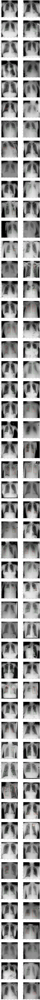

In [12]:
# show a few test image detection example
import pydicom
import cv2
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
import pandas as pd
from ensemble import GeneralEnsemble

filepath = "/data/krf/dataset/stage_1_test_labels.csv"
df = pd.read_csv(filepath)
resize_factor = 2
def visualize(count): 
    #count=1
    
    fig, m_axs = plt.subplots(int(count/2), 2, figsize = (20, 5*count))
    for c_ax,data in zip(m_axs.flatten(),dataloader_test):
#         c_img_arr = pydicom.read_file(c_path).pixel_array
#         # overlay
#         c_img = plt.cm.gray(c_img_arr)
#         c_img += 0.25*plt.cm.hot(prob_image/prob_image.max())
#         c_img = np.clip(c_img, 0, 1)
#         c_ax.imshow(c_img)

#         c_ax.set_title('{class}'.format(**c_rows.iloc[0,:]))
#         for i, (_, c_row) in enumerate(c_rows.dropna().iterrows()):
#             c_ax.plot(c_row['x'], c_row['y'], 's', label='{class}'.format(**c_row))
#             c_ax.add_patch(Rectangle(xy=(c_row['x'], c_row['y']),
#                                     width=c_row['width'],
#                                     height=c_row['height'], 
#                                      alpha = 0.5,
#                                     fill=False))
#             if i==0: c_ax.legend()
    
#         for  in enumerate(dataloader_test):
        patientId = os.path.splitext(os.path.basename(data['names'][0]))[0]
        #print(patientId)
        results = df[df["patientId"]==patientId].values
        boxes_true = np.array([])
        if results[0][5] == 1:
            boxes_true = results[:,1:5]
            #print(boxes_true)
            boxes_true = np.array(boxes_true)
            boxes_true = boxes_true.astype(np.int)

        #print("boxes_true:",boxes_true)
        #print(patientId)
        ds = pydicom.read_file(data['names'][0])
        # original image 
        image = ds.pixel_array
        image2 = image
        if len(image.shape) != 3 or image.shape[2] != 3:
            image = np.stack((image,) * 3, -1)
        c_ax.imshow(image, cmap=plt.cm.gist_gray)
        for j in range(len(boxes_true)):
            bbox = boxes_true[j]
            x1 = int(bbox[0])
            y1 = int(bbox[1])
            w = int(bbox[2])
            h = int(bbox[3])
            x2 = x1+w
            y2 = y1+h
            #cv2.rectangle(image, (x1, y1), (x2, y2),(77, 255, 9),10)
            #print("True:x {} y {} h {} w {}".format(x1, y1, w, h))
            pch = c_ax.add_patch(Rectangle(xy=(x1,y1),width=w,height=h,alpha=0.5,fill=False))
            pch.set_edgecolor('r')
            pch.set_linewidth(3)
            pch.set_label("Ground Truth")
           
        #plt.figure()
        
        with torch.no_grad():
            st = time.time()
            try:
                idxs4 = []
                scores4 = []
                transformed_anchors4 = []
                dets = []
                for i in range(4):
                    scores, classification, transformed_anchors = retinanets[i](data['img'].cuda().float())
                    scores4.append(scores)
                    transformed_anchors4.append(transformed_anchors)
                    #print('Elapsed time: {}'.format(time.time()-st))
                    #print(idxs)
                    idxs = np.where(scores>0.5)
                    #print(idxs)
                    bbox = []
                    idxs4.append(idxs)
#                     for j in range(idxs[0].shape[0]):
#                         boxes_pred = transformed_anchors[idxs[0][j], :]*resize_factor
#                         print("before",i,transformed_anchors[idxs[0][j], :]*resize_factor)
#                         boxes_pred = boxes_pred[np.argsort(scores)[::-1], :]
#                         print("after",i,transformed_anchors[idxs[0][j], :]*resize_factor)
                    bboxes = []
                    for j in range(idxs[0].shape[0]):
                        bbox = transformed_anchors[idxs[0][j], :]*resize_factor
                        bbox = bbox.cpu().numpy()
                        cx = (bbox[0]+bbox[2])/2
                        cy = (bbox[1]+bbox[3])/2
                        w = bbox[2]-bbox[0]
                        h = bbox[3]-bbox[1]
                        s = scores[idxs[0][j]].cpu().numpy()
                        #print("score:",s)
                        bboxes.append([cx,cy,w,h,1,s])
                        #print("before",i,transformed_anchors[idxs[0], :]*resize_factor)
                    if len(bboxes) > 0:
                        dets.append(bboxes)
                #print(dets)
                ensembleBox=[]
                if len(dets) >= 2:
                    ensembleBox = GeneralEnsemble(dets,iou_thresh = 0.4)
                    #print("after ensemble",ensembleBox)
                #break
                boxes_pred = []
                ss = []
                for j in range(len(ensembleBox)):
                    bbox = ensembleBox[j]
                    x1 = int(bbox[0] - bbox[2]/2)
                    y1 = int(bbox[1] - bbox[3]/2)
                    x2 = int(bbox[0] + bbox[2]/2)
                    y2 = int(bbox[1] + bbox[3]/2)
                    width = bbox[2]
                    height = bbox[3]
                    s = bbox[5]
                    #print("score:",s)
                    #ss.append(s)
                    #cv2.rectangle(image2, (x1, y1), (x2, y2),(77, 255, 9),10)
                    width = x2 - x1 
                    height = y2 - y1 
                    #print("Pred:x {} y {} h {} w {}".format(x1, y1, width, height))
                    s = bbox[5]
                    print("score:",s)
                    if s > 0:#MIN CONFIDENCE
                        boxes_pred.append([x1,y1,width,height])
                        ss.append(s)
                boxes_pred = np.array(boxes_pred)
                if len(boxes_pred) > 0:
                    boxes_pred = boxes_pred.astype(np.int)
                #print("boxes_pred:",boxes_pred)
                boxes_pred,ss = nms(boxes_pred,ss,0.2)
                for i,box in enumerate(boxes_pred):
                    pch2 = c_ax.add_patch(Rectangle(xy=(box[0],box[1]),width=box[2],height=box[3],alpha=0.5,fill=False))
                    pch2.set_edgecolor('g')
                    pch2.set_linewidth(3)
                    c_ax.annotate(ss[i],xy=(box[0],box[1]))
                    
                if len(ensembleBox) > 0:
                    count -= 1
                if count <= 0:
                    break#只显示count张图像
        


#                 plt.subplot(1,2,2)
#                 plt.imshow(image2, cmap=plt.cm.gist_gray)
                #plt.savefig(patientId+".png")
            except Exception as e:
                print(e)
                continue
    plt.savefig("test.png")


visualize(100)#显示10张的图像